###Installing dependencies###

In [ ]:
pwd

'/content/drive/My Drive/Age_sd_m/yolov5'

In [ ]:
cd /content/drive/MyDrive/Age_sd_m #set the path acccording to the folder Age_sd_m in directory 

/content/drive/MyDrive/Age_sd_m


In [ ]:
# clone YOLOv5 repository # This must be run once only when installing deps 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

fatal: destination path 'yolov5' already exists and is not an empty directory.
/content/drive/MyDrive/Age_sd_m/yolov5
Checking out files: 100% (75/75), done.
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [ ]:
%cd yolov5 #this must be run rest

[Errno 2] No such file or directory: 'yolov5'
/content/drive/MyDrive/Age_sd_m/yolov5


In [ ]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.9.0+cu102 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [ ]:
cd ..

/content/drive/My Drive/Age_sd_m


In [ ]:
!curl -L "https://app.roboflow.com/ds/zSJ9WXKGpI?key=HFqkE0q5Qx" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip #installing images

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0    917      0 --:--:-- --:--:-- --:--:--   916
100 5988k  100 5988k    0     0  5131k      0  0:00:01  0:00:01 --:--:-- 5131k
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/0d12df28-6795-4693-95e6-baa3c5c7d14b_jpg.rf.8e4de6bcbb4e0adff580ec1a56a855c1.jpg  
 extracting: test/images/12_jpg.rf.51a1483508008941d240b791033d79e7.jpg  
 extracting: test/images/19a85cc5-9226-4f8a-841c-1e05bd8340db_jpg.rf.fa916140734ca6f08798dfec0621df33.jpg  
 extracting: test/images/2b5b6032-b30d-4e88-a888-81aa8b7cd480_jpg.rf.2b294b701af0092190a577082250a405.jpg  
 extracting: test/images/2b7d3151-a306-4590-9687-517b41d8e03a_jpg.rf.3940ee39859c827823b58fcdb3993245.jpg  
 extracting: test/images/35_jpg.rf

In [ ]:
pwd

'/content/drive/My Drive/Age_sd_m'

In [ ]:
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 5
names: ['blackspot', 'darkspot', 'puffyeye', 'puffyeyes', 'wrinkle']

###Define Model Configuration And architecture###

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
%cat ./yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [ ]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
%%writetemplate ./yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [ ]:
# train yolov5s on custom data for epochs
# time its performance
%%time
%cd ./yolov5/
!python train.py --img 416 --batch 16 --epochs 2000 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

Streaming output truncated to the last 5000 lines.
                 all          16          42       0.109      0.0729      0.0246     0.00744

     Epoch   gpu_mem       box       obj       cls     total   targets  img_size
 1002/1999     1.43G   0.03334   0.01843  0.001059   0.05283        31       416: 100% 18/18 [00:02<00:00,  7.34it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 1/1 [00:00<00:00, 10.23it/s]
                 all          16          42       0.566      0.0729      0.0362      0.0122

     Epoch   gpu_mem       box       obj       cls     total   targets  img_size
 1003/1999     1.43G    0.0339   0.01855  0.001176   0.05362        26       416: 100% 18/18 [00:02<00:00,  7.32it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 1/1 [00:00<00:00, 11.02it/s]
                 all          16          42       0.472      0.0729      0.0224     0.00618

     Epoch   

###Some Analysis of model###

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 3283), started 1:53:24 ago. (Use '!kill 3283' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
pwd

'/content/drive/My Drive/Age_sd_m/yolov5'

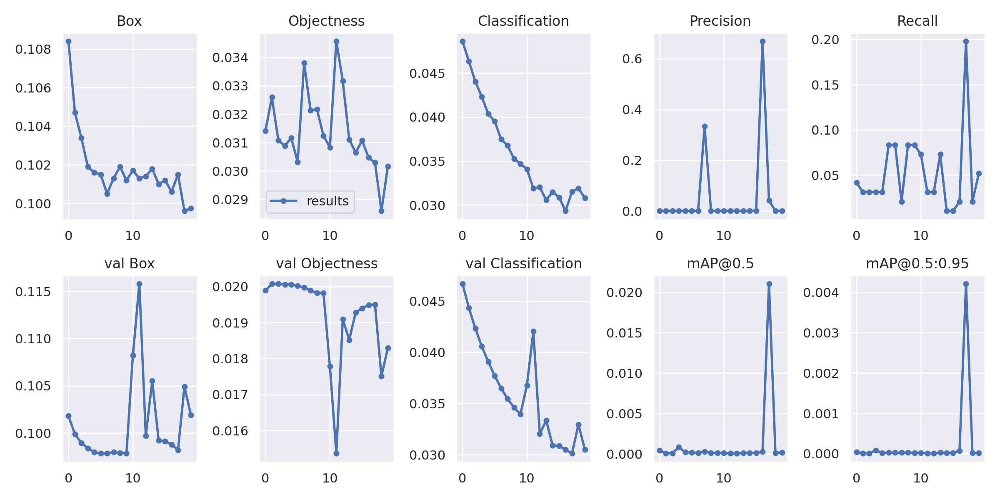

In [ ]:
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='./runs/train/yolov5s_results/results.png', width=1000)

GROUND TRUTH TRAINING DATA:


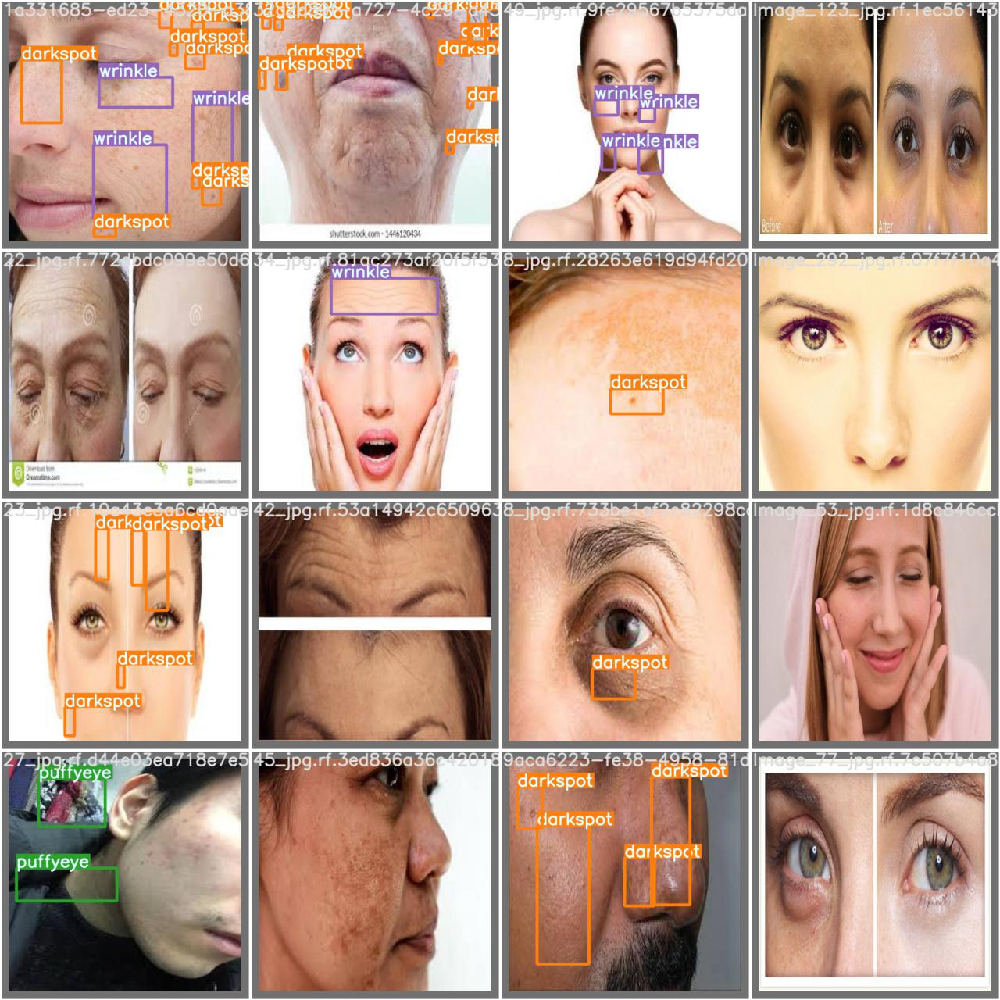

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='./runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


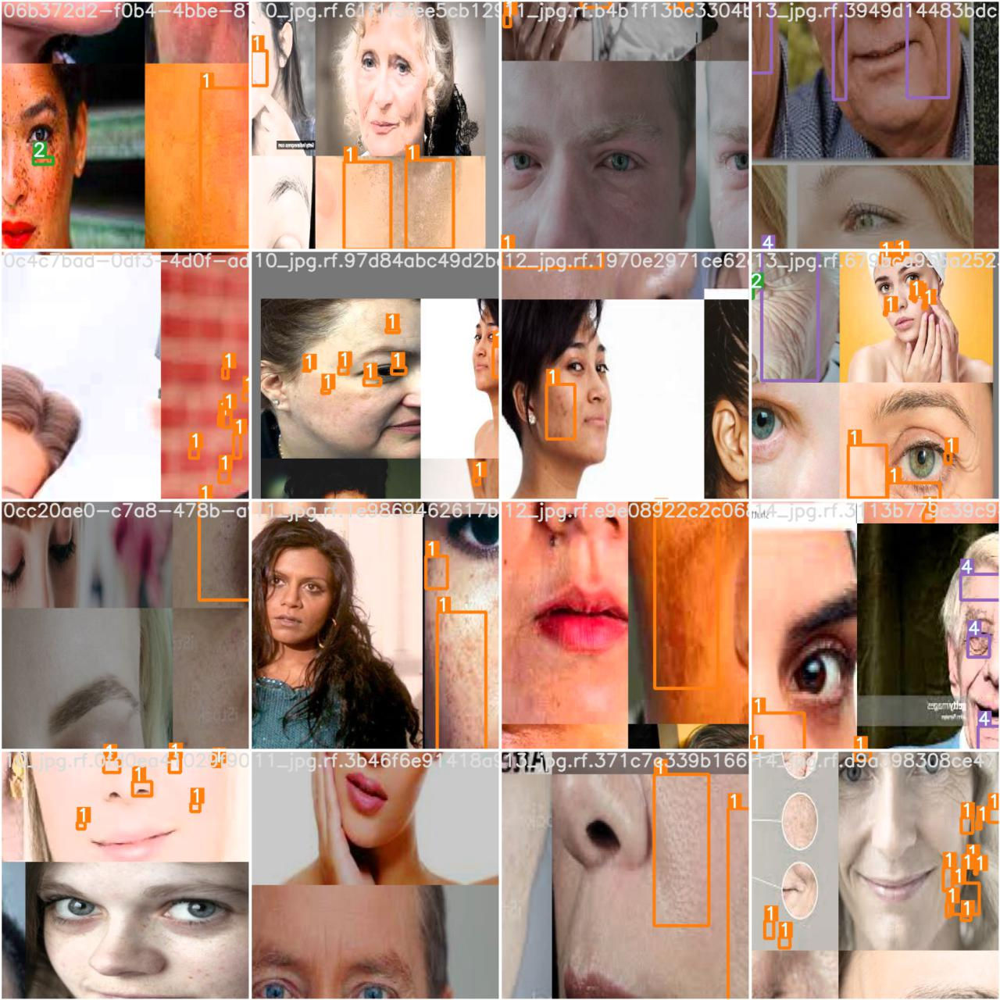

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='./runs/train/yolov5s_results/train_batch0.jpg', width=900)

###Run inference with trained model###

In [ ]:
%ls runs/

detect/  train/


In [ ]:
pwd

'/content/drive/My Drive/Age_sd_m/yolov5'

In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:

!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../train/images/

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../train/images/', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0+cu102 CUDA:0 (Tesla T4, 15109.75MB)

Fusing layers... 
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 232 layers, 7257306 parameters, 0 gradients, 16.8 GFLOPS
image 1/280 /content/drive/My Drive/Age_sd_m/yolov5/../train/images/06b372d2-f0b4-4bbe-8736-13af471cba9e_jpg.rf.9e3fd92

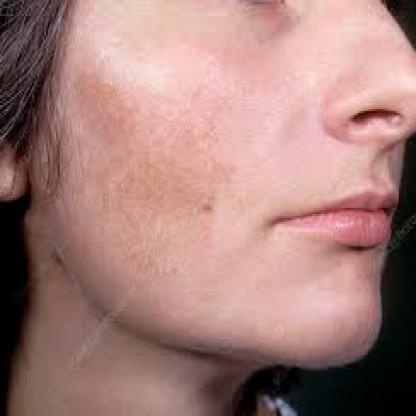

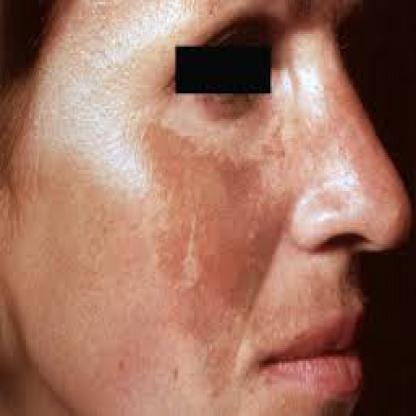

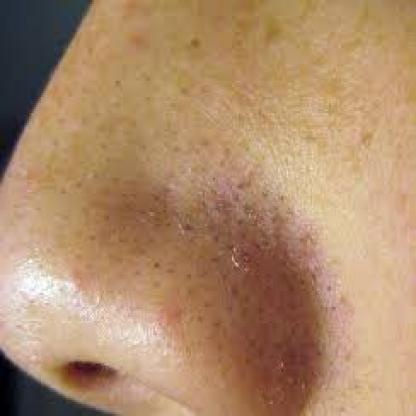

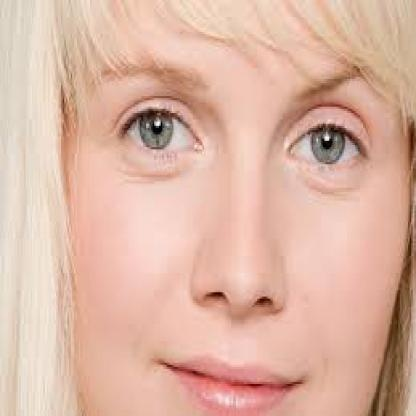

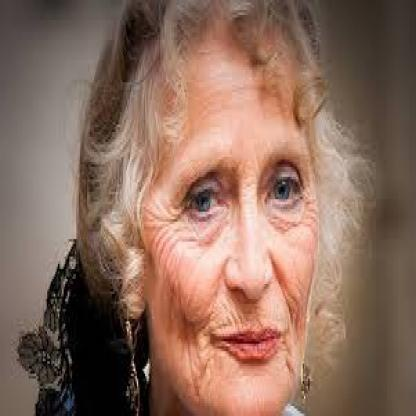

...

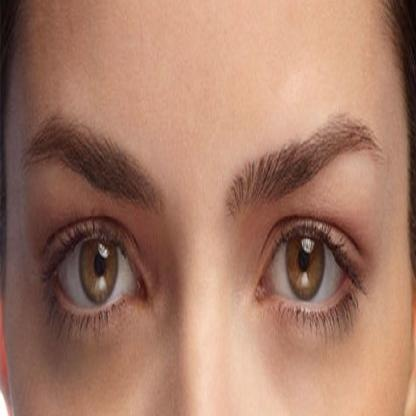

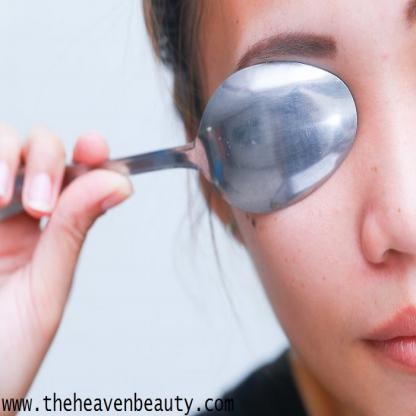

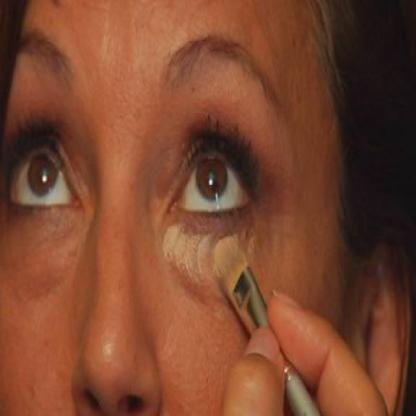

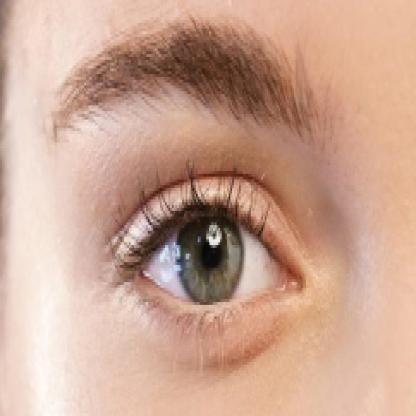

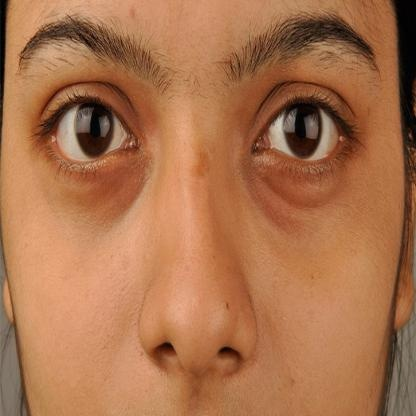

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('./runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

###exporting the model###

In [ ]:
%cp ./runs/train/yolov5s_results/weights/best.pt /content/drive/MyDrive/Age_sd_m/Exported_yolov5

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
